# Quick introduction to jupyter notebooks and how to plot a map of sea ice over the arctic region


---
## 1. (Very) quick intro to jupyter notebooks

* For detailed documentation, see here: https://jupyter-notebook.readthedocs.io/en/stable/.

* **In short, in a jupyter notebook, each "cell" like this one  is either for python code (or bash command) or just for text (in markdown).**

* An example of a code cell is given below. You can run by clicking on the "play" triangle above, or do __SHIFT+ENTER__ after selecting the cell to run:

In [ ]:
# this is python code:

a = 4
b = 5
c = a+b
print(c)

* you can import python packages this way:

In [14]:
## standart libraries
import os,sys
import numpy as np

# xarray
import xarray as xr

# plot
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib import animation
import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from IPython.display import HTML

import cartopy.crs as ccrs
import cartopy.feature as cfeature 
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

#JUPYTER notebook magics
%matplotlib inline 

* define a function for later use (plotting purposes)

In [ ]:
def Fnospines(ax,pspines=False,paxis='off'):
    """
    Remove spines from around the plot
    
    Return: (ax)
    """
    ax.spines['top'].set_visible(pspines)
    ax.spines['right'].set_visible(pspines)
    ax.spines['bottom'].set_visible(pspines)
    ax.spines['left'].set_visible(pspines)
    ax.axis(paxis)

* you can also run `bash` commands by starting the given cell by `%%bash` :

In [2]:
%%bash

ls -lt

total 40
-rw-r--r--  1 leroux  staff  10467 Jun 26 21:59 3-Plot-model-outputs.ipynb
-rw-r--r--  1 leroux  staff   6343 Jun 23 23:14 1-Intro-jupyter-and-data.ipynb


---
## 2. How to plot sea ice model outputs

This example is given from model outputs produced from the neXtSIM lagrangian model. The output file is named Moorings.nc and contains 1 month of 2-time daily outputs. 

* Now let's load one of those files (let's load the sea ice "damage" for example):

In [3]:
diridat = "/Users/leroux/DATA/SASIP/PARAVIEW/data/"
fili    = "Moorings.nc"

dam = xr.open_dataset(diridat+fili)
dam

<xarray.Dataset>
Dimensions:                   (time: 61, nv: 2, y: 1256, x: 1073)
Coordinates:
  * time                      (time) datetime64[ns] 2006-02-01 ... 2006-02-16
Dimensions without coordinates: nv, y, x
Data variables:
    Polar_Stereographic_Grid  int32 ...
    time_bnds                 (time, nv) datetime64[ns] ...
    longitude                 (y, x) float32 ...
    latitude                  (y, x) float32 ...
    siu                       (time, y, x) float32 ...
    siv                       (time, y, x) float32 ...
    sic                       (time, y, x) float32 ...
    damage                    (time, y, x) float32 ...
    ridge_ratio               (time, y, x) float32 ...
    sit                       (time, y, x) float32 ...
Attributes:
    Conventions:  CF-1.6
    institution:  NERSC, Jahnebakken 3, N-5007 Bergen, Norway
    source:       neXtSIM model fields

* Quick plot:

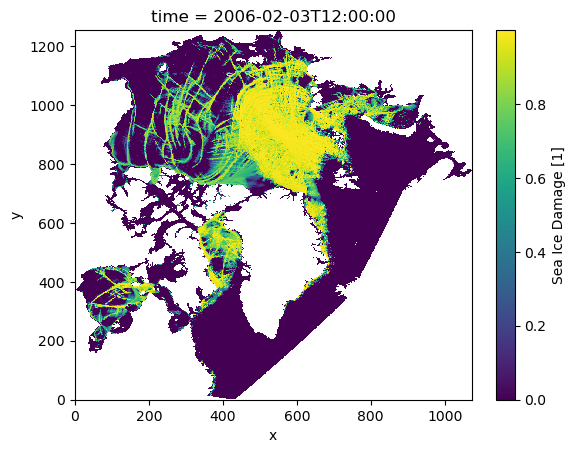

In [5]:
dam["damage"].isel(time=10).plot()

* Customized plot (on native grid)

<function matplotlib.pyplot.show(close=None, block=None)>

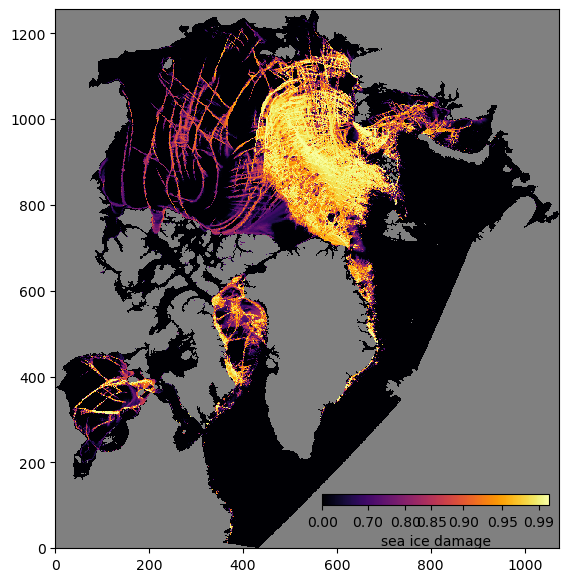

In [11]:
# prepare data to plot at time step it
it=10
data2plt = dam["damage"].isel(time=it)
data2plt_masked = data2plt.where((data2plt<100))

# prepare colormap
cmap = cm.inferno
cmap.set_bad('gray',1.)

norm = mcolors.PowerNorm(gamma=4.5,vmin=0, vmax=1)

# create figure
fig,(ax) = plt.subplots(1, 1, figsize=[6.5, 7],facecolor='w')

# plot
p = ax.pcolormesh(data2plt,cmap=cmap,norm=norm)


# add colorbar
cblev=[0,0.7,0.8,0.85,0.9,0.95,0.99]
axins1 = inset_axes(ax,
                        height="10%",  # height : 5%
                            width="50%",
                        bbox_to_anchor=(0.08, -0.1,0.9,0.2),
                        bbox_transform=ax.transAxes,
                        borderpad=0)
cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap),
             cax=axins1, orientation='horizontal',ticks=cblev,label='sea ice damage')

# show plot on jupyter notebook below
plt.show

* animate the plot with time (on native grid)

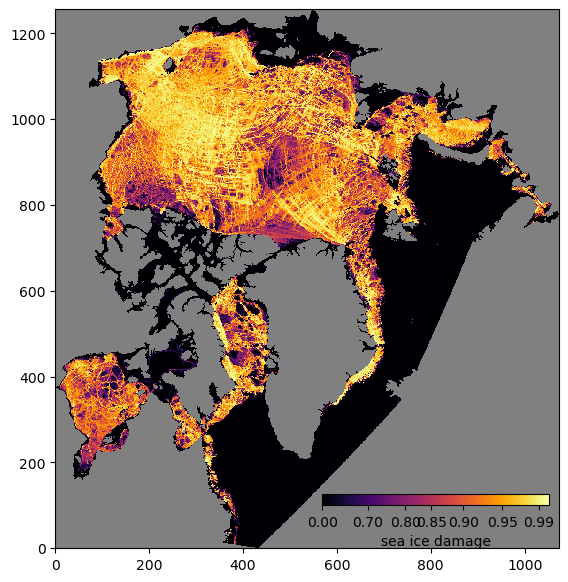

In [49]:
# Number of timesteps in the output file
NTIME = data2plt.time.size

# select colormap and set gray color for missing values (i.e. for land)
cmap = cm.inferno
cmap.set_bad('gray',1.)
norm = mcolors.PowerNorm(gamma=4.5,vmin=0, vmax=1)


data2plt = dam["damage"]
data2plt_masked = data2plt.where((data2plt<100))


fig,(ax) = plt.subplots(1, 1, figsize=[6.5, 7],facecolor='w')

#plot
it=0
p = ax.pcolormesh(data2plt_masked.isel(time=it),norm=norm,cmap=cmap)

# add date
#da = printdate(unixt=float(data2plt_masked.time[it].values))
#d = ax.annotate(da, xy=(4, 113),  fontsize=12, color="w")

# add colorbar
# add colorbar
cblev=[0,0.7,0.8,0.85,0.9,0.95,0.99]
axins1 = inset_axes(ax,
                        height="10%",  # height : 5%
                            width="50%",
                        bbox_to_anchor=(0.08, -0.1,0.9,0.2),
                        bbox_transform=ax.transAxes,
                        borderpad=0)
cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap),
             cax=axins1, orientation='horizontal',ticks=cblev,label='sea ice damage')


def animate(it):
    p.set_array(data2plt_masked.isel(time=it))
    #da = printdate(unixt=float(data2plt_masked.time[it].values))
    #d = ax.annotate(da, xy=(4, 113),  fontsize=12, color="w",backgroundcolor='gray')
    return p,

def init():
    p.set_array(data2plt_masked.isel(time=0))
    return p,

ani = animation.FuncAnimation(fig=fig,
                              func=animate,
                              init_func=init,
                              frames=NTIME,
                              interval=100,
                              blit=True)

HTML(ani.to_jshtml())

---
## 3. Plot using geographic projection

* Create map over arctic region without data

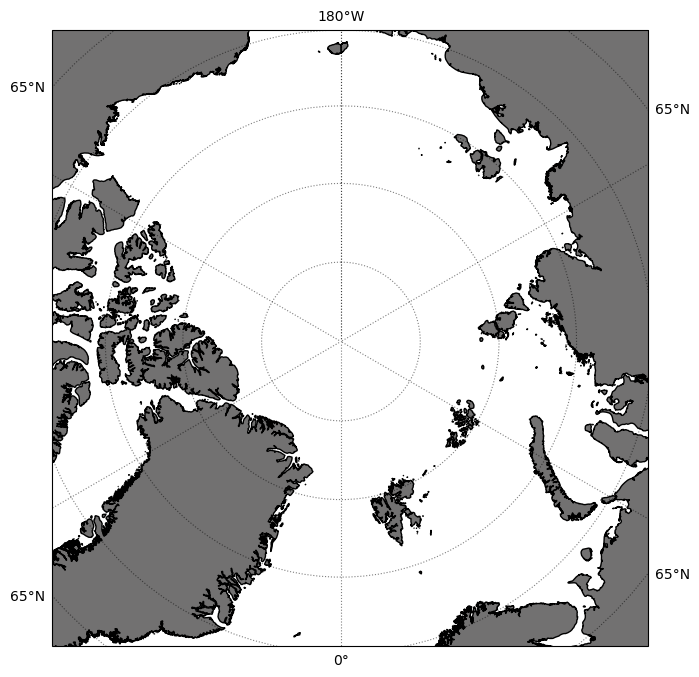

In [44]:
#========= CREATE FIGURE
fig3 = plt.figure(figsize=([8,8]),facecolor='white')

#========= PLOT DATA
# Data system proj (if coords are in lat lon, use PlateCarre here)
trdata  = ccrs.PlateCarree() 

# Now use Orthographic projection over Arctic region
ax = plt.axes(projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90.0)) 
ax.set_extent([-180, 180, 70, 90], trdata)

# continents
land = cfeature.GSHHSFeature(scale='intermediate',
                                     levels=[1],
                                     facecolor='#727171')
#land = cfeature.GSHHSFeature(scale='intermediate',
#                                     levels=[1],
#                                     facecolor=cfeature.COLORS['sea'])
ax.add_feature(land)

# gridlines
gl = ax.gridlines(draw_labels=True, linestyle=':', color='black',
                          alpha=0.5)
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
ax.tick_params('both',labelsize=22)

# function to make sure there is no spurious frame around the plot
Fnospines(ax,pspines=False,paxis='on')


* Add trajectories

/Users/leroux/anaconda3/envs/jupy/lib/python3.11/site-packages/cartopy/mpl/geoaxes.py:1700: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  result = super().scatter(*args, **kwargs)


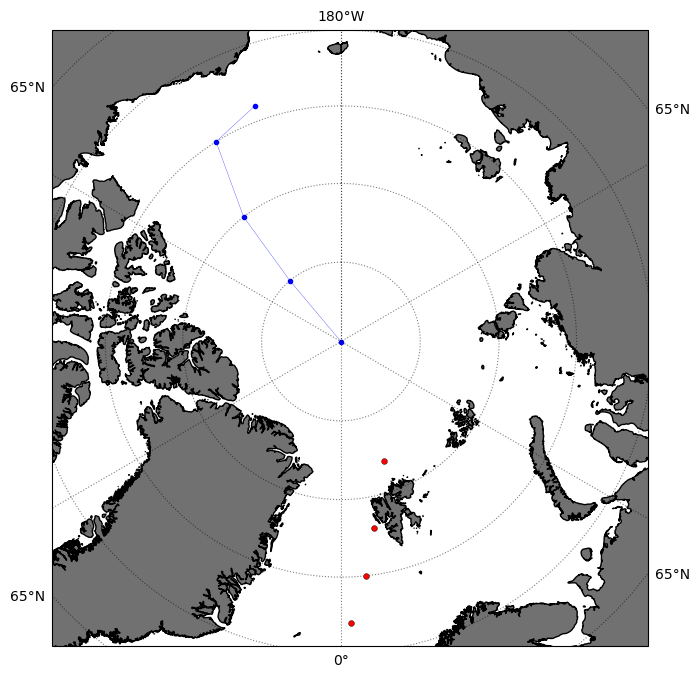

In [43]:
#========= CREATE FIGURE
fig3 = plt.figure(figsize=([8,8]),facecolor='white')

#========= PLOT DATA
# Data system proj (if coords are in lat lon, use PlateCarre here)
trdata  = ccrs.PlateCarree() 

# Now use Orthographic projection over Arctic region
ax = plt.axes(projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90.0)) 
ax.set_extent([-180, 180, 70, 90], trdata)

# continents
land = cfeature.GSHHSFeature(scale='intermediate',
                                     levels=[1],
                                     facecolor='#727171')
#land = cfeature.GSHHSFeature(scale='intermediate',
#                                     levels=[1],
#                                     facecolor=cfeature.COLORS['sea'])
ax.add_feature(land)

# gridlines
gl = ax.gridlines(draw_labels=True, linestyle=':', color='black',
                          alpha=0.5)
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
ax.tick_params('both',labelsize=22)

# function to make sure there is no spurious frame around the plot
Fnospines(ax,pspines=False,paxis='on')


# Plot lat-lon points
lonpt2=[-160,-148,-142,-140,-140]
latpt2=[74,75,80,85,90]

lonpt=[0,2,6,10,20]
latpt=[70,72,75,78,82]

# plot broken line and points
traj2=plt.plot(lonpt2,latpt2,'-',linewidth=0.2, color='b',marker='.',transform=trdata)

# plot scattered points (no line in between)
traj=plt.scatter(x=lonpt,
               y=latpt,
               alpha=1, 
               s=70,
            linewidths=0.3,
            marker='.',
            facecolors='r', 
            edgecolors='k',
            transform=trdata,
            cmap='inferno_r',
            zorder=20) 



* test